<a href="https://colab.research.google.com/github/halldm2000/NOAA-AI-2020-TUTORIAL/blob/master/curve_fitting_sea_ice.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### Curve Fitting with PyTorch


In [4]:
# Download sea-ice extent data

source = "ftp://sidads.colorado.edu/DATASETS/NOAA/G02135/north/daily/data/N_seaice_extent_daily_v3.0.csv"
dest    = "/content/data/"
!wget  -c -e robots=off -P {dest} {source}

--2020-10-19 16:16:01--  ftp://sidads.colorado.edu/DATASETS/NOAA/G02135/north/daily/data/N_seaice_extent_daily_v3.0.csv
           => ‘/content/data/N_seaice_extent_daily_v3.0.csv’
Resolving sidads.colorado.edu (sidads.colorado.edu)... 128.138.135.20
Connecting to sidads.colorado.edu (sidads.colorado.edu)|128.138.135.20|:21... connected.
Logging in as anonymous ... Logged in!
==> SYST ... done.    ==> PWD ... done.
==> TYPE I ... done.  ==> CWD (1) /DATASETS/NOAA/G02135/north/daily/data ... done.
==> SIZE N_seaice_extent_daily_v3.0.csv ... 1555921
==> PASV ... done.    ==> RETR N_seaice_extent_daily_v3.0.csv ... done.
Length: 1555921 (1.5M) (unauthoritative)

N_seaice_extent_dai 100%[===================>]   1.48M  1022KB/s    in 1.5s    

2020-10-19 16:16:03 (1022 KB/s) - ‘/content/data/N_seaice_extent_daily_v3.0.csv’ saved [1555921]



In [48]:
import matplotlib.pyplot as plt
!mkdir -p images

def load_extent_data():

    import numpy as np
    from datetime import datetime, timedelta
    sec_per_day = 3600*24

    csv    = "/content/data/N_seaice_extent_daily_v3.0.csv"
    data   = np.loadtxt(csv, skiprows=2, delimiter=',', usecols=(0,1,2,3,4))
    extent = data[:,3]
    time   = np.zeros_like(extent)
    nrows  = data.shape[0]
    start  = datetime(1978,1,1)

    for i in range(nrows):
      yr, day, hr, mn = data[i,0:4].astype(int)
      date = datetime(yr,day,hr,mn)
      time[i] = (date-start).total_seconds()/sec_per_day

    return torch.tensor(time)%365, torch.tensor(extent)

def plot():
  global frame

  terms = [f"${w[i]:+.1f} X^{i} $" for i in range(len(w))]
  eqn = "y ="+ ''.join(terms)+ f"     $X = x - {x0[0]:.2f}$"
  
  plt.figure(figsize=(10,7.5),dpi=72*1.25)
  plt.plot(x_train,y_train,'.',alpha = 0.1, markersize=5)
  plt.plot(x_val,y_val,'.',alpha = 0.1, markersize=5);
  plt.ylim(y.min(), y.max())
  plt.xlabel("day of the year", fontsize=12)
  plt.ylabel("million sq km ", fontsize=12);
  plt.title(f"Annual Artic Sea-ice Extent. epoch={epoch} \n",fontsize=14)
  plt.text(0.5, 1.02, eqn, transform=plt.gca().transAxes, fontsize=10, horizontalalignment='center')

  ypred = model(x)
  plt.plot(x,ypred,'.',color='black', markersize=5);
  
  plt.savefig(f'./images/img_{plot.frame:04d}',bbox_inches='tight');
  plot.frame+=1
  plt.show()

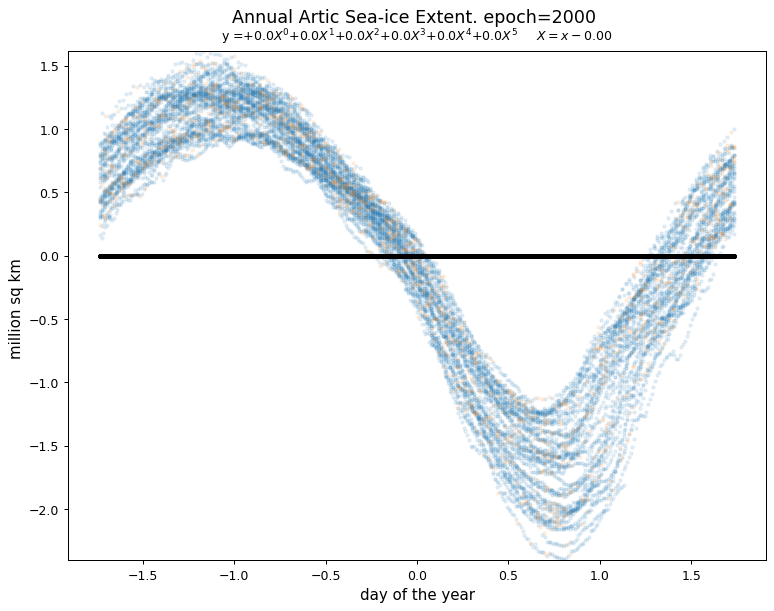

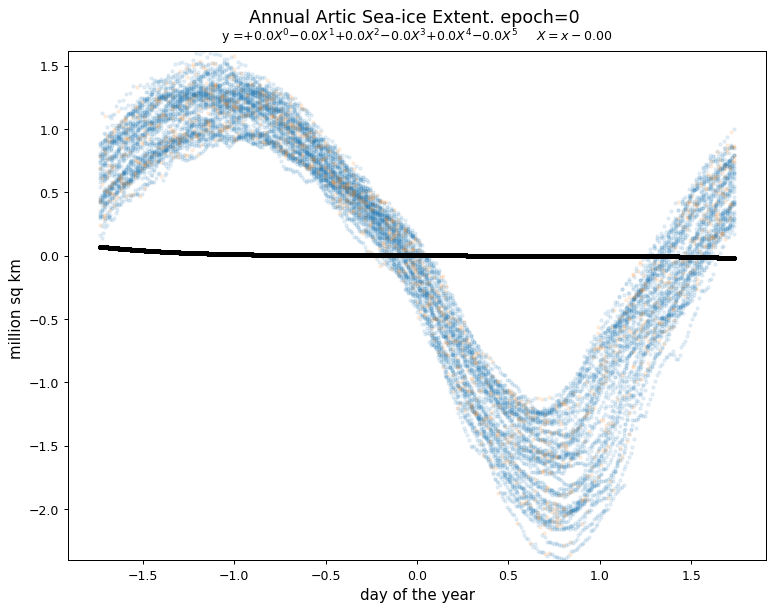

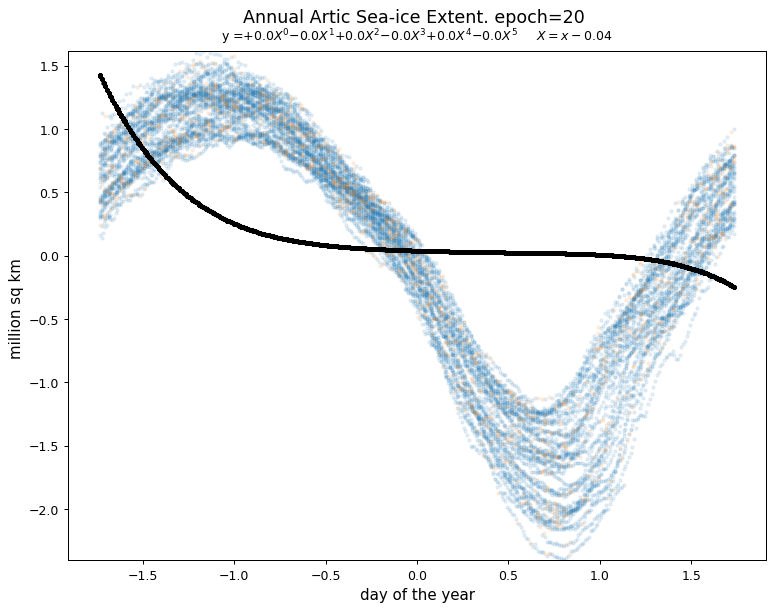

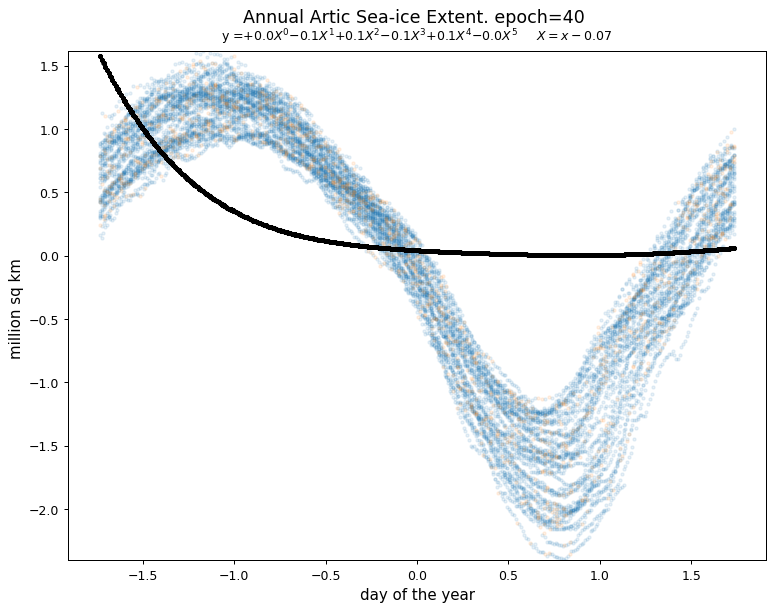

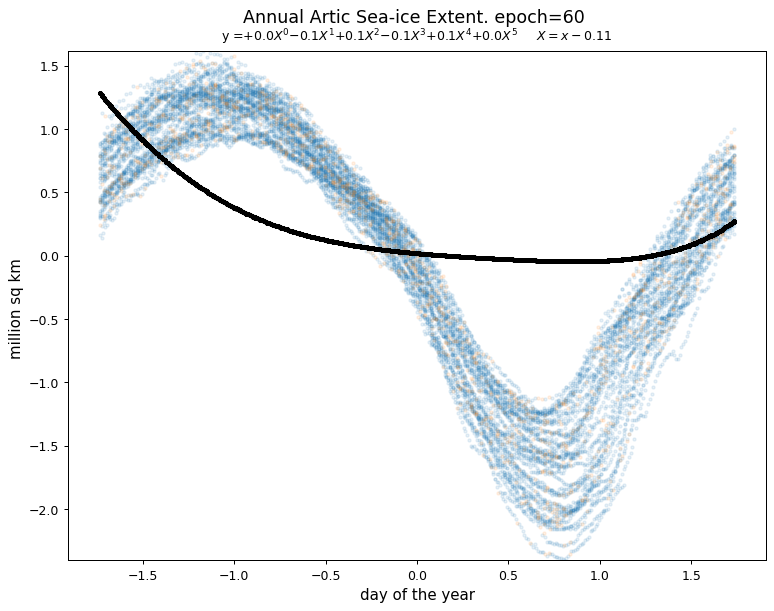

...

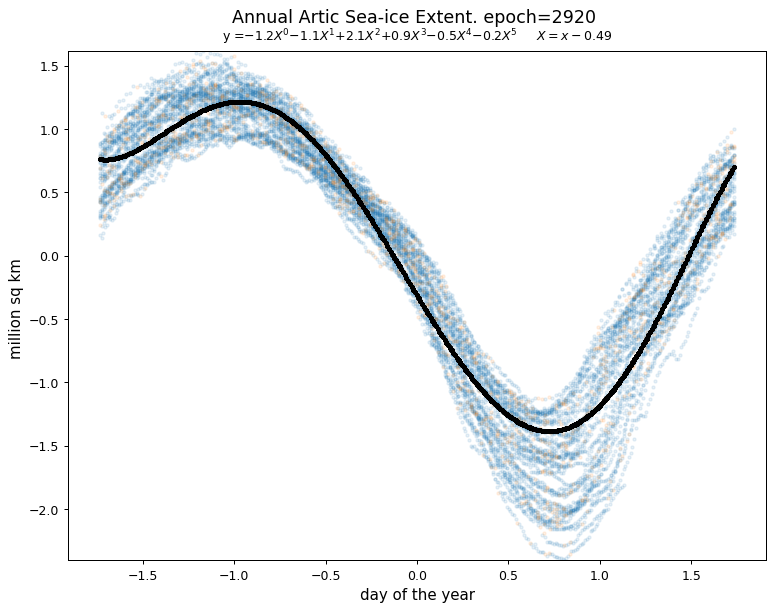

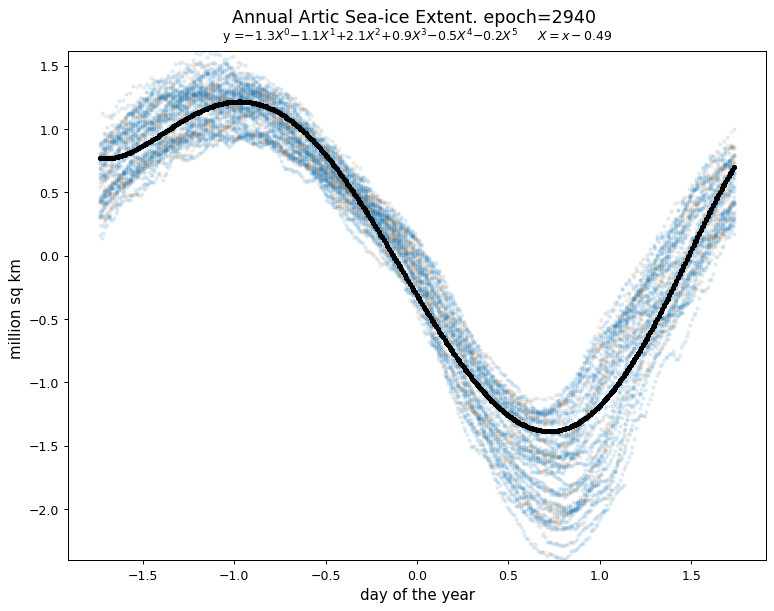

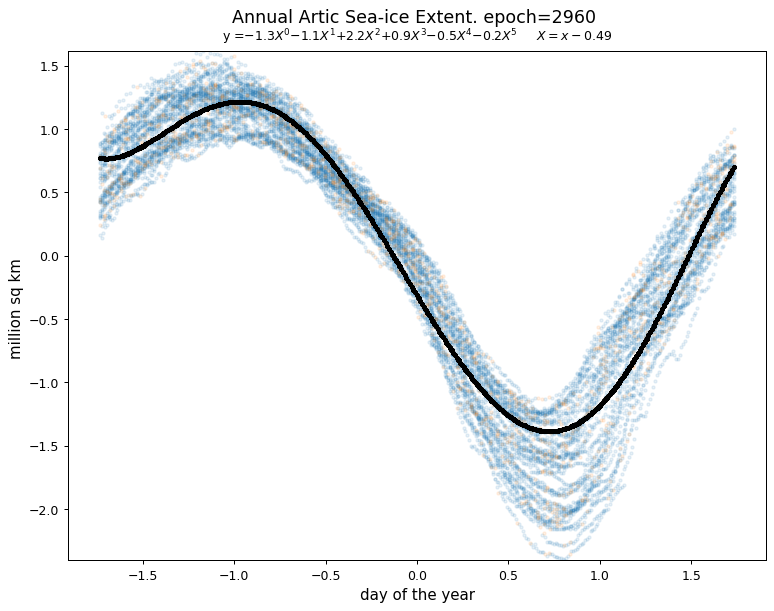

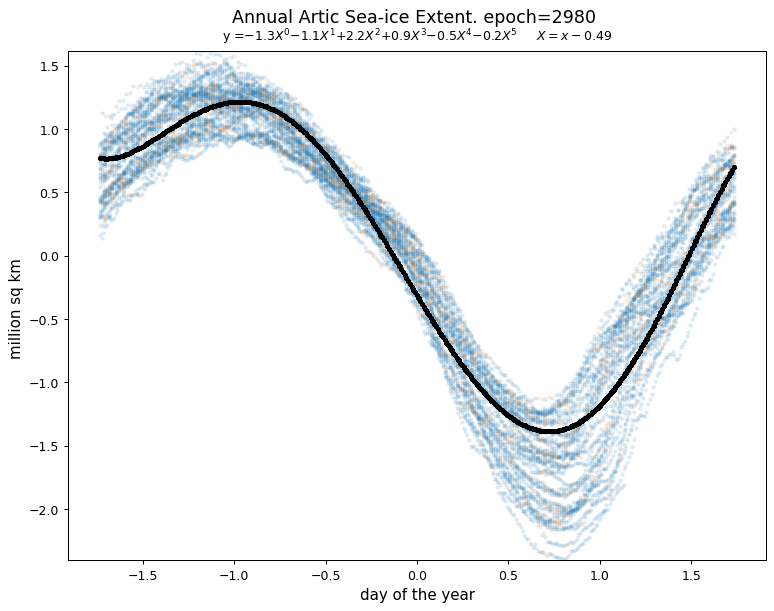

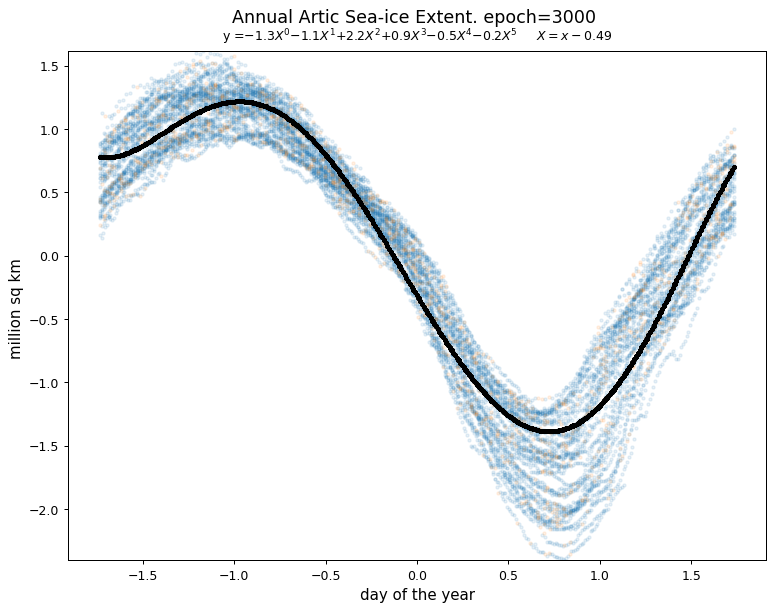

In [53]:

import torch
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
torch.manual_seed(0)

# DATA

x,y = load_extent_data()
xscaler = StandardScaler()
yscaler = StandardScaler()
x = torch.from_numpy(xscaler.fit_transform(x.view(-1,1)))
y = torch.from_numpy(yscaler.fit_transform(y.view(-1,1)))
x_train, x_val, y_train, y_val = train_test_split(x, y, test_size=0.10, random_state=1)

# MODEL

order = 5
x0 = torch.zeros(1,       requires_grad=True)
w  = torch.zeros(order+1, requires_grad=True)
def model(x): return sum( w[i]*(x-x0)**i for i in range(len(w)) ) 

# OPTIMIZER
optimizer = torch.optim.AdamW(params = [x0,w], lr=2e-3)
#loss_fcn = torch.nn.MSELoss()
loss_fcn = torch.nn.L1Loss()

train_loss, val_loss=[],[]
plot.frame =0
with torch.no_grad(): plot()

for epoch in range(3001):

  # TRAIN
  p_train = model(x_train)
  optimizer.zero_grad()
  #loss = (p_train-y_train).abs().mean()
  loss = loss_fcn(p_train,y_train)
  loss.backward()
  optimizer.step()
  train_loss.append(loss.item())

  with torch.no_grad():

    # VALIDATE
    p_val = model(x_val)
    loss_val = (p_val-y_val).abs().mean()
    val_loss.append(loss_val.item())

    if epoch%20 == 0: plot()


In [54]:
!ffmpeg -loglevel warning -i ./images/img_%04d.png -vf scale=1280:-2 -pix_fmt yuv420p -y out.mp4

In [55]:
from IPython.display import HTML
from base64 import b64encode
mp4 = open('out.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML("""
<video width=800 controls><source src="%s" type="video/mp4"></video>
""" % data_url)

In [46]:
!rm ./images/img_*.png